# Classification - Mini-Project 2

## Dataset Description

The data set includes information about:

- Customers who left within the last month – the column is called Churn
- Services that each customer has signed up for – phone, multiple lines, internet, online security, online backup, device protection, tech support, and streaming TV and movies
- Customer account information – how long they’ve been a customer, contract, payment method, paperless billing, monthly charges, and total charges
- Demographic info about customers – gender, age range, and if they have partners and dependents

Each row represents a customer, and each column represents customer attributes as described below.

| Column | Description|
|-|-|
|gender|Whether the customer is a male or a female|
|SeniorCitizen| Whether the customer is a senior citizen or not (1, 0)|
|Partner|Whether the customer has a partner or not (Yes, No)|
|Dependents|Whether the customer has dependents or not (Yes, No)|
|tenure| Number of months the customer has stayed with the company|
|PhoneService|Whether the customer has a phone service or not (Yes, No)|
|MultipleLines|Whether the customer has multiple lines or not (Yes, No, No phone service*)|
|InternetService|Customer’s internet service provider (DSL, Fiber optic, No)|
|OnlineSecurity|Whether the customer has online security or not (Yes, No, No internet service**)|
|OnlineBackup|Whether the customer has online backup or not (Yes, No, No internet service)|
|DeviceProtection|Whether the customer has device protection or not (Yes, No, No internet service)|
|TechSupport|Whether the customer has tech support or not (Yes, No, No internet service)|
|StreamingTV|Whether the customer has streaming TV or not (Yes, No, No internet service) |
|StreamingMovies|Whether the customer has streaming movies or not (Yes, No, No internet service)|
|Contract|The contract term of the customer (Month-to-month, One year, Two year)|
|PaperlessBilling|Whether the customer has paperless billing or not (Yes, No)|
|PaymentMethod|The customer’s payment method (Electronic check, Mailed check, Bank transfer (automatic), Credit card (automatic))|
|MonthlyCharges|The amount charged to the customer monthly|
|TotalCharges|The total amount charged to the customer|
|Churn|Whether the customer churned or not (Yes or No)|

\* No phone service means the customer's plan does not include calling (could be a data-only plan)

\*\* No internet service means the customer's plan does not include internet/data and so the addon package does not apply

## Importing Libraries & Dataset

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.filterwarnings("ignore", category=DeprecationWarning)
%matplotlib inline
plt.style.use("seaborn")

df = pd.read_csv('https://raw.githubusercontent.com/GUC-DM/W2022/main/data/telecom_churn.csv')

df.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,$29.85/m,$29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,$56.95/m,$1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,$53.85/m,$108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),$42.3/m,$1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,$70.7/m,$151.65,Yes


## Data Inspection

In [2]:
# check the datatypes of the columns
df.info()
# check if there are columns with null values
df.isnull().sum()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7032 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   customerID        6976 non-null   object
 1   gender            7032 non-null   object
 2   SeniorCitizen     7032 non-null   int64 
 3   Partner           7032 non-null   object
 4   Dependents        7032 non-null   object
 5   tenure            7032 non-null   int64 
 6   PhoneService      7032 non-null   object
 7   MultipleLines     7032 non-null   object
 8   InternetService   7032 non-null   object
 9   OnlineSecurity    7032 non-null   object
 10  OnlineBackup      7032 non-null   object
 11  DeviceProtection  7032 non-null   object
 12  TechSupport       7032 non-null   object
 13  StreamingTV       7032 non-null   object
 14  StreamingMovies   7032 non-null   object
 15  Contract          7032 non-null   object
 16  PaperlessBilling  7032 non-null   object
 17  PaymentMethod 

customerID           56
gender                0
SeniorCitizen         0
Partner               0
Dependents            0
tenure                0
PhoneService          0
MultipleLines         0
InternetService       0
OnlineSecurity        0
OnlineBackup          0
DeviceProtection      0
TechSupport           0
StreamingTV           0
StreamingMovies       0
Contract              0
PaperlessBilling      0
PaymentMethod         0
MonthlyCharges        0
TotalCharges        852
Churn                 0
dtype: int64

## Data Cleaning

In [3]:
# Remove $ and /m and convert MonthlyCharges and TotalCharges to float
df['MonthlyCharges']=df['MonthlyCharges'].str.replace('$',"")
df['MonthlyCharges']=df['MonthlyCharges'].str.replace('/m',"").astype(float)
df['TotalCharges']=df['TotalCharges'].str.replace('$',"").astype(float)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7032 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        6976 non-null   object 
 1   gender            7032 non-null   object 
 2   SeniorCitizen     7032 non-null   int64  
 3   Partner           7032 non-null   object 
 4   Dependents        7032 non-null   object 
 5   tenure            7032 non-null   int64  
 6   PhoneService      7032 non-null   object 
 7   MultipleLines     7032 non-null   object 
 8   InternetService   7032 non-null   object 
 9   OnlineSecurity    7032 non-null   object 
 10  OnlineBackup      7032 non-null   object 
 11  DeviceProtection  7032 non-null   object 
 12  TechSupport       7032 non-null   object 
 13  StreamingTV       7032 non-null   object 
 14  StreamingMovies   7032 non-null   object 
 15  Contract          7032 non-null   object 
 16  PaperlessBilling  7032 non-null   object 


In [4]:
df.shape

(7032, 21)

In [5]:
# Replace null values in the totalcharges column with the mode
mode = df['TotalCharges'].mode()
df['TotalCharges'] = df['TotalCharges'].fillna(mode[0]).astype(float)
# DropNA in customerID
df.dropna(inplace=True)
df.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6976 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        6976 non-null   object 
 1   gender            6976 non-null   object 
 2   SeniorCitizen     6976 non-null   int64  
 3   Partner           6976 non-null   object 
 4   Dependents        6976 non-null   object 
 5   tenure            6976 non-null   int64  
 6   PhoneService      6976 non-null   object 
 7   MultipleLines     6976 non-null   object 
 8   InternetService   6976 non-null   object 
 9   OnlineSecurity    6976 non-null   object 
 10  OnlineBackup      6976 non-null   object 
 11  DeviceProtection  6976 non-null   object 
 12  TechSupport       6976 non-null   object 
 13  StreamingTV       6976 non-null   object 
 14  StreamingMovies   6976 non-null   object 
 15  Contract          6976 non-null   object 
 16  PaperlessBilling  6976 non-null   object 


In [7]:
# Convert the seniorcitizen column from int to object, because it's binary (Yes or No)
df=df.replace({'SeniorCitizen':{0:'No',1:'Yes'}})
df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6976 entries, 0 to 7031
Data columns (total 21 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   customerID        6976 non-null   object 
 1   gender            6976 non-null   object 
 2   SeniorCitizen     6976 non-null   object 
 3   Partner           6976 non-null   object 
 4   Dependents        6976 non-null   object 
 5   tenure            6976 non-null   int64  
 6   PhoneService      6976 non-null   object 
 7   MultipleLines     6976 non-null   object 
 8   InternetService   6976 non-null   object 
 9   OnlineSecurity    6976 non-null   object 
 10  OnlineBackup      6976 non-null   object 
 11  DeviceProtection  6976 non-null   object 
 12  TechSupport       6976 non-null   object 
 13  StreamingTV       6976 non-null   object 
 14  StreamingMovies   6976 non-null   object 
 15  Contract          6976 non-null   object 
 16  PaperlessBilling  6976 non-null   object 


,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,No,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,No,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,3668-QPYBK,Male,No,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,No,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,No,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


In [8]:
# Get the unique values for each column
for column in df.columns:
    print(f"{column} : {df[column].unique()}")
    print("--------------------------------------")

customerID : ['7590-VHVEG' '5575-GNVDE' '3668-QPYBK' ... '4801-JZAZL' '8361-LTMKD'
 '3186-AJIEK']
--------------------------------------
gender : ['Female' 'Male']
--------------------------------------
SeniorCitizen : ['No' 'Yes']
--------------------------------------
Partner : ['Yes' 'No']
--------------------------------------
Dependents : ['No' 'Yes']
--------------------------------------
tenure : [ 1 34  2 45  8 22 10 28 62 13 16 58 49 25 69 52 71 21 12 30 47 72 17 27
  5 46 11 70 63 43 15 60 18 66  9  3 31 50 64 56  7 42 35 48 29 65 38 68
 32 55 37 36 41  6  4 33 23 57 61 14 20 53 40 59 24 44 19 54 51 67 26 39]
--------------------------------------
PhoneService : ['No' 'Yes']
--------------------------------------
MultipleLines : ['No phone service' 'No' 'Yes']
--------------------------------------
InternetService : ['DSL' 'Fiber optic' 'No']
--------------------------------------
OnlineSecurity : ['No' 'Yes' 'No internet service']
--------------------------------------
Onlin

In [9]:
# Drop unecessary and redundant columns
# df.drop(['customerID','MultipleLines','OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport','StreamingTV',
# 'StreamingMovies','Dependents','PaperlessBilling'], axis="columns", inplace=True)
df.drop(['customerID'], axis="columns", inplace=True)

In [10]:
# Get the number of unique values in each column
for column in df.columns:
    print(f"{column}: Number of unique values {df[column].nunique()}")
    print("------------------------------------------------------------")

gender: Number of unique values 2
------------------------------------------------------------
SeniorCitizen: Number of unique values 2
------------------------------------------------------------
Partner: Number of unique values 2
------------------------------------------------------------
Dependents: Number of unique values 2
------------------------------------------------------------
tenure: Number of unique values 72
------------------------------------------------------------
PhoneService: Number of unique values 2
------------------------------------------------------------
MultipleLines: Number of unique values 3
------------------------------------------------------------
InternetService: Number of unique values 3
------------------------------------------------------------
OnlineSecurity: Number of unique values 3
------------------------------------------------------------
OnlineBackup: Number of unique values 3
------------------------------------------------------------
D

In [11]:
# categorical columns values 
categorical_col = []
for column in df.columns:
    if df[column].dtype == object:
        categorical_col.append(column)
        print(f"{column} : {df[column].unique()}")
        print("-----------------------------------")

gender : ['Female' 'Male']
-----------------------------------
SeniorCitizen : ['No' 'Yes']
-----------------------------------
Partner : ['Yes' 'No']
-----------------------------------
Dependents : ['No' 'Yes']
-----------------------------------
PhoneService : ['No' 'Yes']
-----------------------------------
MultipleLines : ['No phone service' 'No' 'Yes']
-----------------------------------
InternetService : ['DSL' 'Fiber optic' 'No']
-----------------------------------
OnlineSecurity : ['No' 'Yes' 'No internet service']
-----------------------------------
OnlineBackup : ['Yes' 'No' 'No internet service']
-----------------------------------
DeviceProtection : ['No' 'Yes' 'No internet service']
-----------------------------------
TechSupport : ['No' 'Yes' 'No internet service']
-----------------------------------
StreamingTV : ['No' 'Yes' 'No internet service']
-----------------------------------
StreamingMovies : ['No' 'Yes' 'No internet service']
-----------------------------------

In [12]:
# convert contract to oridinal categorical attribute 
df['Contract'] = pd.Categorical(df['Contract'],
                                      categories=['Month-to-month', 'One year', 'Two year'],
                                      ordered=True)
df[df['Contract']<='One year']

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,OnlineBackup,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,Female,No,Yes,No,1,No,No phone service,DSL,No,Yes,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,Male,No,No,No,34,Yes,No,DSL,Yes,No,Yes,No,No,No,One year,No,Mailed check,56.95,1889.50,No
2,Male,No,No,No,2,Yes,No,DSL,Yes,Yes,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,Male,No,No,No,45,No,No phone service,DSL,Yes,No,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,Female,No,No,No,2,Yes,No,Fiber optic,No,No,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7025,Female,No,No,No,12,No,No phone service,DSL,No,Yes,Yes,Yes,Yes,Yes,One year,No,Electronic check,60.65,743.30,No
7027,Male,No,Yes,Yes,24,Yes,Yes,DSL,Yes,No,Yes,Yes,Yes,Yes,One year,Yes,Mailed check,84.80,1990.50,No
7028,Female,No,Yes,Yes,72,Yes,Yes,Fiber optic,No,Yes,Yes,No,Yes,Yes,One year,Yes,Credit card (automatic),103.20,7362.90,No
7029,Female,No,Yes,Yes,11,No,No phone service,DSL,Yes,No,No,No,No,No,Month-to-month,Yes,Electronic check,29.60,346.45,No


In [13]:
# Label encoding of Churn column to convert it into a numerical column of 0-1 (binary= True/False)
df['Churn'] = df['Churn'].astype('category').cat.codes
df['Churn']

0       0
1       0
2       1
3       0
4       1
       ..
7027    0
7028    0
7029    0
7030    1
7031    0
Name: Churn, Length: 6976, dtype: int8

## Exploratory Data Analysis

**Q1: What are the most correlated attributes with customer churn?**

**Visualization**

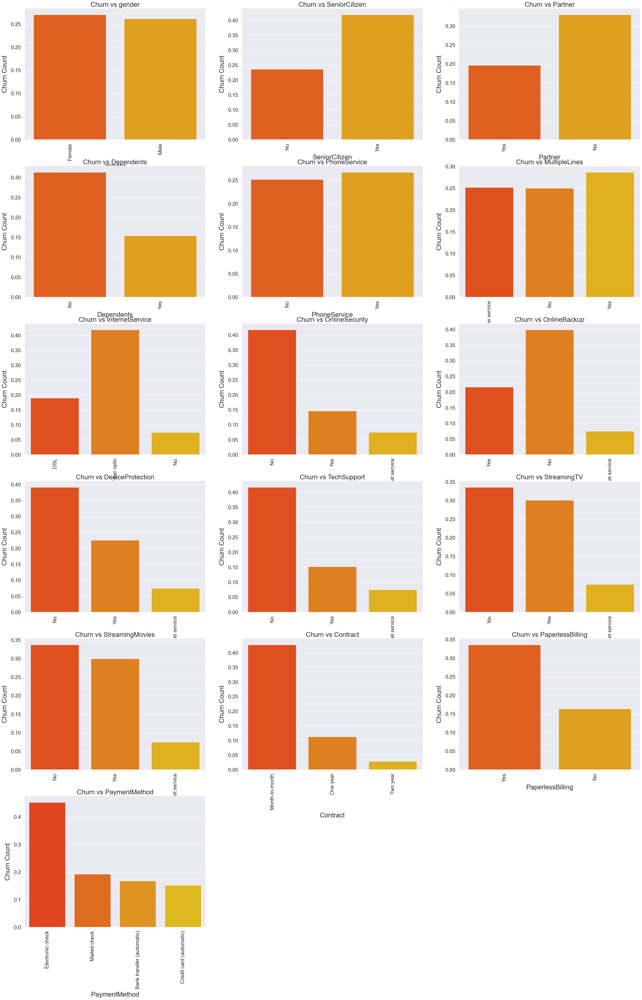

In [14]:
categorical_features = categorical_col.copy()
categorical_features.remove('Churn')

# Plotting every feature average in relation to the "Churn"
sns.set(font_scale=1.7)
plt.figure(figsize=(40, 60))

for i, column in enumerate(categorical_features, 1):
    plt.subplot(6, 3, i)
    g = sns.barplot(x=column, y='Churn', data=df,ci=False,palette='autumn')
    g.set_xticklabels(g.get_xticklabels(), rotation=90)
    plt.title('Churn vs '+f'{column}',fontsize=24)
    plt.ylabel('Churn Count',labelpad=10,fontsize=24)
    plt.xlabel(f'{column}',labelpad=10,fontsize=24)
    plt.rcParams['figure.dpi'] = 700
    plt.rcParams['savefig.dpi'] = 700

Let's also make a heatmap to see the accurate correlation, in terms of actual numbers, but first we'll need to encode the dataframe in order to be able to use the .corr() function since it only takes numerical values and we mostly have categorical (object) attributes

In [15]:
# convert the columns to nominal values (integers) in order to be able to do a correlation heatmap
df_encoded = df.copy()
# df_encoded['Contract'] = df_encoded['Contract'].cat.codes
df_encoded = pd.get_dummies(df_encoded, columns=categorical_features)
#drop the redundant columns, because they are binary/boolean (Yes or No)
df_encoded.drop(['gender_Female','Partner_No','PhoneService_No','SeniorCitizen_No','Dependents_No',
'PaperlessBilling_No'], axis='columns', inplace=True)
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6976 entries, 0 to 7031
Data columns (total 41 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   tenure                                   6976 non-null   int64  
 1   MonthlyCharges                           6976 non-null   float64
 2   TotalCharges                             6976 non-null   float64
 3   Churn                                    6976 non-null   int8   
 4   gender_Male                              6976 non-null   uint8  
 5   SeniorCitizen_Yes                        6976 non-null   uint8  
 6   Partner_Yes                              6976 non-null   uint8  
 7   Dependents_Yes                           6976 non-null   uint8  
 8   PhoneService_Yes                         6976 non-null   uint8  
 9   MultipleLines_No                         6976 non-null   uint8  
 10  MultipleLines_No phone service           6976 no

In [16]:
plt.figure(figsize = (37,31))
# sns.set(font_scale=1.01)
ax=sns.heatmap(df_encoded.corr(),annot=True, cmap='afmhot_r',linewidths=.8,vmin=-0.5,vmax=1,annot_kws={"size": 15})
plt.title('Correlation of attributes with Churn',fontsize=25)
plt.tick_params(axis='both', which='major', labelsize=25)
plt.rcParams['figure.dpi'] = 1500
plt.rcParams['savefig.dpi'] = 1500
plt.tight_layout()
for spine in ax.spines.values():
    spine.set(visible=True, lw=.8, edgecolor="black")
for label in ax.xaxis.get_ticklabels():
    if label.get_text() == 'Churn':
        label.set_fontsize(30)
        label.set_fontweight('bold')
        label.set_color('red')

**Answer for Q1**:

-   Gender: Female users tend to have more churn than male users, the difference is not that high tho

-   Partner: Users with no partners have a higher churn rate than users with partners, in other words not-married (not-couples) tend to have a higher churn rate. Probably due to less comitments

-   PhoneService: Users with Phoneservice have a higher churn rate than users without phoneservice

-   InternetService: Users with FiberOptic have higher churn rate than users with DSL and no Internetservice at all. People who have DSL are the second highest churning customers

-   Contract: Customers with Month-to-month contracts have a very high churn rate, compared to users with one-year and two-year contracts. One-year contracts are the second highest churning customers

-   PaymentMethod: Customers paying with an electronic check have the highest churning rates followed by mailed checks and bank transfer (automatic)

-   SeniorCitizens have a higher churn rate than non-Seniorcitizens

-   People without dependants tend to have a lower churn rate than people with dependants, which explains why people without partners also have a higher churn rate than people without partners

-   People with Multiple Lines have a higher churn rate than people without

-   Users without Online Security have a clear higher amount of churn rate than people with online security

-   Users without Online Backup have a clear higher amount of churn rate than people with online backup

-   Users without Device Protection have a higher amount of churn rate than people with Device protection

-   Users without Tech-support have a higher amount of churn rate than people with Tech-support

-   Users without Streaming TV have a slightly higher amount of churn rate than people with Streaming TV, followed closely by people who have Streaming TV

-    Users without Streaming Movies have a slightly higher amount of churn rate than people with Streaming Movies, followed closely by people who have Streaming Movies

-    Users with Paperless Biling have a higher amount of churn rate than people without Paperless Biling
---

The most correlated variables with Churn are:

1. Payment Method - Electronic check (0.3)
2. Contract - Month-to-month (0.4)
3. Internet Service - Fiber Optic (0.31)
4. Phone Service - Yes (0.01) > not so high
5. Seniorcitizen - Yes (0.15)
6. Monthly Charges (0.19)
7. PaperlessBilling - Yes (0.19)
8. StreamingMovies - No (0.13) > not so high
9. StreamingTV - No (0.13) > not so high
10. TechSupport - No (0.34)
11. DeviceProtection - No (0.25)
12. OnlineBackup - No (0.27)
13. OnlineSecurity - No (0.34)
14. MonthlyCharges (0.19)


**Q2: Which payment method has the highest churn rate?**

**Visualization**

In [17]:
sns.barplot(y='PaymentMethod',x='Churn',data=df,ci=False,palette='copper')
plt.title('PaymentMethod vs Churn rate',y=1.05,x=0.2)
plt.xlabel('Churn',labelpad=10)
plt.ylabel('Payment Method',labelpad=20)
plt.rcParams['figure.dpi'] = 500
plt.rcParams['savefig.dpi'] = 500

**Answer for Q2**:

The payment method with the highest churn rate is the electronic check, followed by the mailed check

**Q3: After how many months do customers commonly churn?** (Hint: show and interpret the distribution)

**Visualization**

<AxesSubplot: xlabel='Churn', ylabel='tenure'>

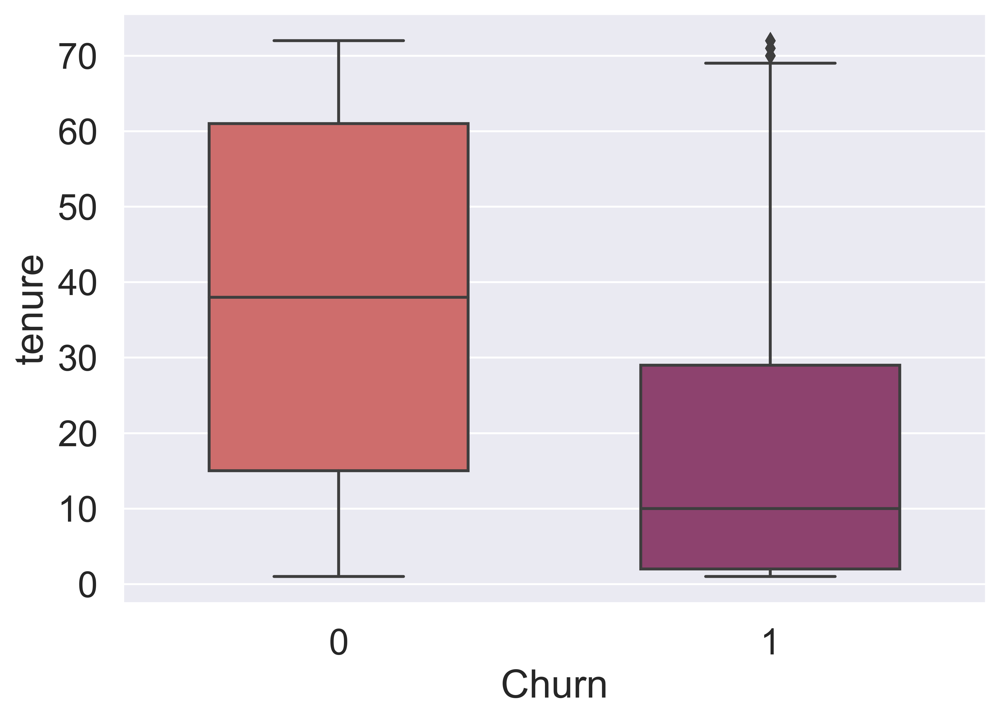

In [18]:
sns.boxplot(y='tenure',x='Churn',data=df,palette='flare',width=.6)

In [19]:
# median
print("Median: ",(df['tenure'].groupby(df['Churn']==1).median()),'\n','--------------------------------')
print("25% quantile: ",df['tenure'].groupby(df['Churn']==1).quantile(q=0.25),'\n','--------------------------------')
print("50% quantile: ",df['tenure'].groupby(df['Churn']==1).quantile(q=0.5),'\n','--------------------------------')
print("75% quantile: ",df['tenure'].groupby(df['Churn']==1).quantile(q=0.75),'\n','--------------------------------')

Median:  Churn
False    38.0
True     10.0
Name: tenure, dtype: float64 
 --------------------------------
25% quantile:  Churn
False    15.0
True      2.0
Name: tenure, dtype: float64 
 --------------------------------
50% quantile:  Churn
False    38.0
True     10.0
Name: tenure, dtype: float64 
 --------------------------------
75% quantile:  Churn
False    61.0
True     29.0
Name: tenure, dtype: float64 
 --------------------------------


Since we looked at the distribution, let's look at the count (number) of tenure and Churn=1 (mode basically)

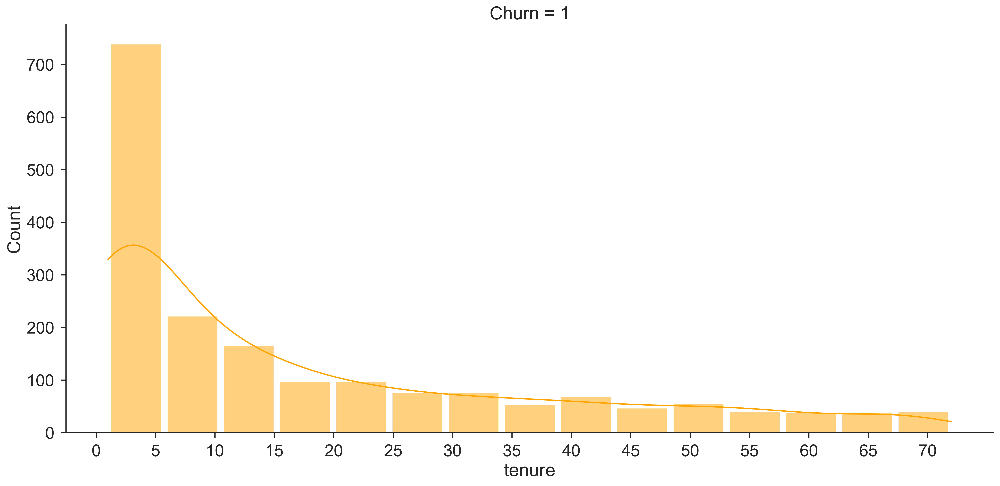

In [20]:
sns.set_style('ticks')
# fig=sns.displot(x='tenure',data=df,height=8,aspect=2,hue='Churn',kde=True,multiple='dodge',palette='gist_heat_r',
# shrink=.9)
fig=sns.displot(x='tenure',data=df,height=8,aspect=2,col='Churn',col_order=[1],kde=True,multiple='dodge',color='orange',
shrink=.9)
fig.set(xticks=np.arange(0, max(df['tenure'])+1, 5))
plt.rcParams['figure.dpi'] = 500
plt.rcParams['savefig.dpi'] = 500

**Answer for Q3**:

Most customers churn after 1-2 months but not less than 5 months, so in the range of 1-5 months is where most customers churn the most. The boxplot however, also shows a median of 10, meaning that on average people tend to churn after 10 months. So on average people tend to churn after 10 months, but most people (mode) leave after 1-5 months
-   Distribution (boxplot where Churn=True):
    1. At 25% (quantile)            >> 2 months
    2. At 50% (quantile/median)     >> 10 months
    3. At 75% (quantile)            >> 29 months


## Data Preparation for Modelling

In [21]:
# the encoding was done before, when we made the heatmap > we'll use it again now
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6976 entries, 0 to 7031
Data columns (total 41 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   tenure                                   6976 non-null   int64  
 1   MonthlyCharges                           6976 non-null   float64
 2   TotalCharges                             6976 non-null   float64
 3   Churn                                    6976 non-null   int8   
 4   gender_Male                              6976 non-null   uint8  
 5   SeniorCitizen_Yes                        6976 non-null   uint8  
 6   Partner_Yes                              6976 non-null   uint8  
 7   Dependents_Yes                           6976 non-null   uint8  
 8   PhoneService_Yes                         6976 non-null   uint8  
 9   MultipleLines_No                         6976 non-null   uint8  
 10  MultipleLines_No phone service           6976 no

In [22]:
# test to get the best random state 
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

x = df_encoded.drop('Churn',axis=1)     # Independent variables - remove the dependant variable
y = df_encoded['Churn']                 # Dependent variable
random_states = np.arange(start=0, stop=100)
scores=[]
tree_clf = DecisionTreeClassifier()
for state in random_states:
    # 30 % for testing and 70% for training
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.3, random_state=state)
    tree_clf.fit(x_train, y_train)  #fit the model
    R_square = tree_clf.score(x_test,y_test)
    t='Best R^2 obtained is:'+str(R_square)+' RS='+str(state)
    scores.append(t)    
print(max(scores)) #print the best score

Best R^2 obtained is:0.7515527950310559 RS=20


In [23]:
#  Split the data into 30 % for testing and 70% for training
from sklearn.model_selection import train_test_split

X = df_encoded.drop('Churn', axis=1)    # Independent variables - remove the dependant variable
y = df_encoded['Churn']                 # Dependent variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=38)

## Modelling

In [24]:
from sklearn.tree import DecisionTreeClassifier

tree_clf = DecisionTreeClassifier(random_state=12)
tree_clf.fit(X_train, y_train) #fit the model

DecisionTreeClassifier(random_state=12)

In [25]:
""" # Please remove the triple quotes in this line if the pip installation of the libraries is needed
%pip install graphviz """;

### Tree Visualization

In [26]:
# import needed libraries to graph the decision tree
import graphviz
from sklearn.tree import export_graphviz

dot_data = export_graphviz(tree_clf, out_file=None,
                           feature_names=X.columns,
                           class_names=['No', 'Yes'],
                           filled=True, rounded=True,
                           special_characters=True) 
graph = graphviz.Source(dot_data)
graph
# alternatively, to export:
# graph.render('Churn') # >> pdf or svg

Example Rule:
IF (Contract= Month-to-month) AND (tenure < 70.5) AND (MonthlyCharges > 96.575) AND (PaymentMethod= Bank transfer (automatic)) THEN gender = Male

## Evaluation

In [27]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
# score format
def print_score(clf, X_train, y_train, X_test, y_test, train=True):
    if train:
        pred = clf.predict(X_train)
        clf_report = pd.DataFrame(classification_report(y_train, pred, output_dict=True))
        print("Train Result:")
        print("===============================================")
        print(f"Accuracy Score: {accuracy_score(y_train, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_train, pred)}\n")
        
    elif train==False:
        pred = clf.predict(X_test)
        clf_report = pd.DataFrame(classification_report(y_test, pred, output_dict=True))
        print("Test Result:")
        print("===============================================")
        print(f"Accuracy Score: {accuracy_score(y_test, pred) * 100:.2f}%")
        print("_______________________________________________")
        print(f"CLASSIFICATION REPORT:\n{clf_report}")
        print("_______________________________________________")
        print(f"Confusion Matrix: \n {confusion_matrix(y_test, pred)}\n")

In [28]:
# Print the scores
print_score(tree_clf, X_train, y_train, X_test, y_test, train=True)
print_score(tree_clf, X_train, y_train, X_test, y_test, train=False)

Train Result:
Accuracy Score: 99.82%
_______________________________________________
CLASSIFICATION REPORT:
                     0            1  accuracy    macro avg  weighted avg
precision     0.997477     1.000000  0.998157     0.998738      0.998162
recall        1.000000     0.993208  0.998157     0.996604      0.998157
f1-score      0.998737     0.996592  0.998157     0.997665      0.998155
support    3558.000000  1325.000000  0.998157  4883.000000   4883.000000
_______________________________________________
Confusion Matrix: 
 [[3558    0]
 [   9 1316]]

Test Result:
Accuracy Score: 74.73%
_______________________________________________
CLASSIFICATION REPORT:
                     0           1  accuracy    macro avg  weighted avg
precision     0.835714    0.500904  0.747253     0.668309      0.750932
recall        0.823417    0.522642  0.747253     0.673029      0.747253
f1-score      0.829520    0.511542  0.747253     0.670531      0.749000
support    1563.000000  530.000000  

 We achieved an Accuracy score of 99.82 on our Training dataset (30%) and 74.73% on our Test dataset (70%)

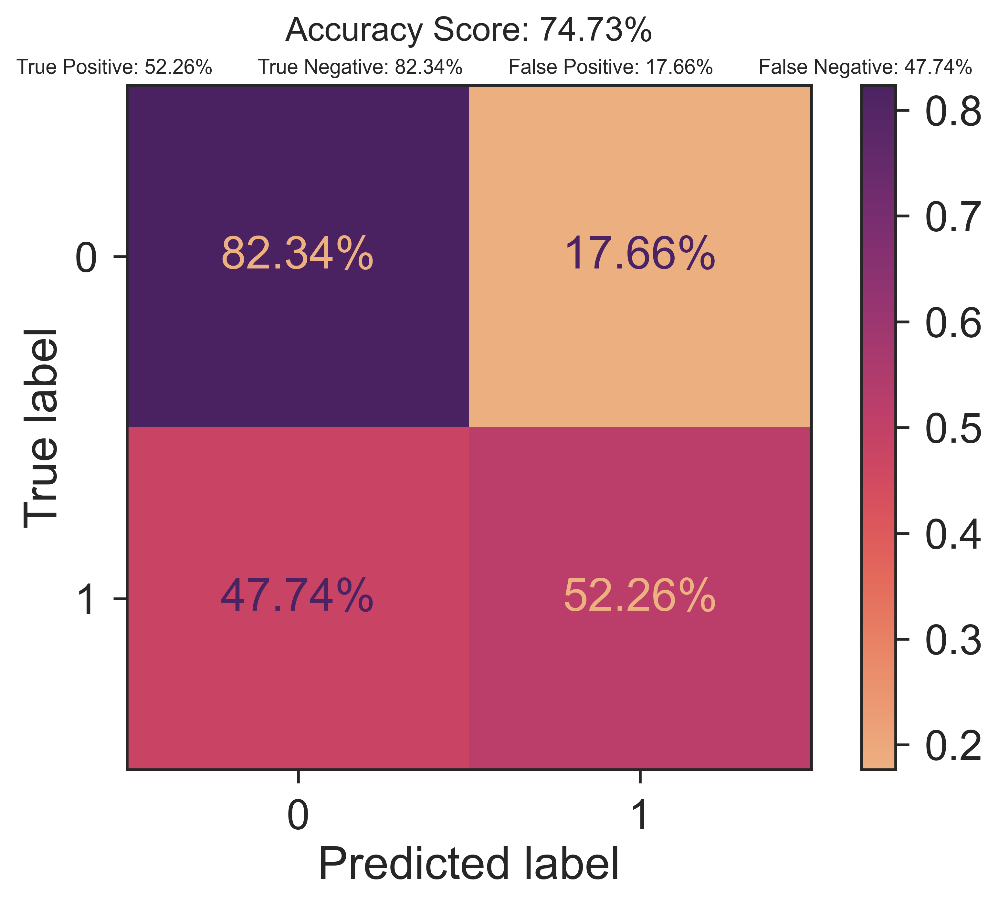

In [29]:
from sklearn.metrics import plot_confusion_matrix,confusion_matrix,accuracy_score
# plot confusion matrix as a heatmap
pred = tree_clf.predict(X_test)
plot_confusion_matrix(tree_clf, X_test, y_test, cmap='flare', normalize='true',values_format='.2%')
plt.grid(False)
score=accuracy_score(y_test, pred)
plt.title('Accuracy Score: {:.2%}'.format(score), size = 15,pad=20);
cm= confusion_matrix(y_test,pred)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
sup='True Positive: '+'{:.2%}'.format(cm[1][1])+' '*8+'True Negative: '+ '{:.2%}'.format(cm[0][0]
)+' '*8+'False Positive: '+'{:.2%}'.format(cm[0][1])+' '*8+'False Negative: '+'{:.2%}'.format(cm[1][0])
plt.suptitle(str(sup),size=9,y=.91);

In [30]:
cm= confusion_matrix(y_test,pred)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
print('True Positive', '{:.2%}'.format(cm[1][1]))
print('True Negative', '{:.2%}'.format(cm[0][0]))
print('False Positive','{:.2%}'.format(cm[0][1]))
print('False Negative','{:.2%}'.format(cm[1][0]))

True Positive 52.26%
True Negative 82.34%
False Positive 17.66%
False Negative 47.74%


The Confusion matrix is a performance measurement for machine learning classification problem where output can be two or more classes. It is a table with 4 different combinations of predicted and actual values.
1. True Positive  (TP) - Bottom right quadrant
    -   You predicted positive and it’s true.
2. True Negative  (TN) - Top left quadrant
    -   You predicted negative and it’s true.
3. False Positive (FP) - Top right quadrant
    -    You predicted positive and it’s false.
4. False Negative (FN) - Bottom left quadrant
    -    You predicted negative and it’s false.

In [31]:
from sklearn.metrics import f1_score, precision_score, recall_score,accuracy_score,roc_curve
#print model precision
pred = tree_clf.predict(X_test)
print('Precision: ','{:.1%}'.format(precision_score(y_test,pred)),'\n','--------------------------------------')
print('Recall: ','{:.1%}'.format(recall_score(y_test,pred)),'\n','--------------------------------------')
print('F-measure: ','{:.1%}'.format(f1_score(y_test,pred)),'\n','--------------------------------------')
print('Accuracy: ','{:.1%}'.format(accuracy_score(y_test,pred)),'\n','--------------------------------------')
print('Missclassification Rate (Error rate): ','{:.1%}'.format(1-accuracy_score(y_test,pred)),'\n')

Precision:  50.1% 
 --------------------------------------
Recall:  52.3% 
 --------------------------------------
F-measure:  51.2% 
 --------------------------------------
Accuracy:  74.7% 
 --------------------------------------
Missclassification Rate (Error rate):  25.3% 



To comment on the model performance let's look at what these measures mean:
1. Precision:
    - From all the classes we have predicted as positive, how many are actually positive (Should be as high as possible)
2. Accuracy:
    - From all the classes (positive and negative), how many of them we have predicted correctly (Should be as high as possible)
3. F-measure:
    - F-score helps to measure Recall and Precision at the same time
4. Missclassification Rate:
    - How often is the model wrong
     

# ROC Curve (Receiver operating characteristic Curve)
-   This is a plot that displays the sensitivity(TP-rate) and specificity (TN-rate)

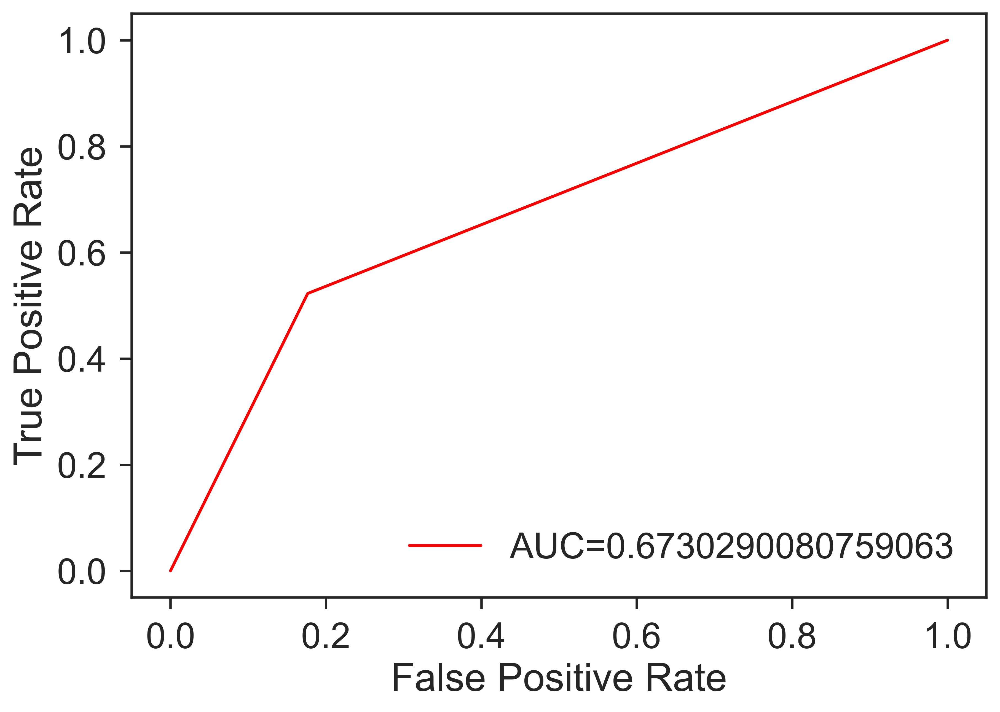

In [32]:
from sklearn import metrics
fpr, tpr, _ = metrics.roc_curve(y_test, pred)
auc = metrics.roc_auc_score(y_test, pred)
plt.plot(fpr,tpr,label="AUC="+str(auc),color='red') # Area under the curve
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

As we can see, the model does a good job of classifing the data into categories. We also calculated the AUC (Area under the curve) to know how much of the plot is located under the curve. The closer AUC is to 1, the better the model. Since we have a AUC of 0.66, it means that out model is doing a good job of classifying data

In [33]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold

clf = DecisionTreeClassifier(random_state=12)
# since we have a relatively small dataset (~1000 records), 
# we'll use a low number of splits
skf = StratifiedKFold(n_splits=3)

# Note how cross validation is applied on the training dataset
# The testing dataset is always left out and used -only- in the final evaluation
scores = cross_val_score(clf, X_train, y_train, cv=skf, scoring='f1')
scores

array([0.49662921, 0.48844884, 0.44925884])

In [34]:
print("Score: %0.2f (+/- %0.2f)" % (scores.mean(), scores.std() * 2))

Score: 0.48 (+/- 0.04)


# The results were as follows:
-   With the Decsion Tree algorithm we managed to get:
    - A model Precision of 50.1 %
    - A model accuracy of 74.7 %
    - A model recall of 52.3 %
    - A model F-measure of 51.2 %
    - A model Error Rate of 25.3 %
    - A model True Positive of 52.26 %
    - A model True Negative of 82.34 %
    - A model False Positive of 17.66 %
    - A model False Negative of 47.74 %
    - A model AUC of 67.30 %

The decision tree model we've done above has a decent outcome. The model has a good Accuracy meaning, from all the classes (positive and negative) the model predicted them correctly 74.7 % of the time. The model also has a decent Precision. The error rate could be brought lower; The model is 25.3 % of the time wrong. From the confusion matrix we can also tell that the model predicts negative classes better than positive classes. 82.34 % True Negative compared to 52.26 % True positive. We also calculated the AUC (Area under the curve) to know how much of the plot is located under the curve. The closer AUC is to 1, the better the model. Since we have a AUC of 0.67, it means that out model is doing a good job of classifying data

## Bonus (Optional)

We're going to prupose 2 new algorithms and compare their performance along with the initial Decision Tree algorithm to see which of the three is better and should be chosen

# Algorithm #1: Gaussian Naive Bayes

In [35]:
# Naive Bayes
from sklearn.naive_bayes import GaussianNB
x = df_encoded.drop('Churn',axis=1) # Independent variables - remove the dependant variable
y = df_encoded['Churn'] # Dependent variable
X_train, X_test, y_train, y_test = train_test_split(x,y, test_size=0.25, random_state=0)
gnb = GaussianNB()
gnb.fit(X_train, y_train)
y_pred = gnb.predict(X_test)
from sklearn import metrics
score=metrics.accuracy_score(y_test, y_pred)
print("Gaussian Naive Bayes model accuracy: ",'{:.2%}'.format(score))

Gaussian Naive Bayes model accuracy:  67.83%


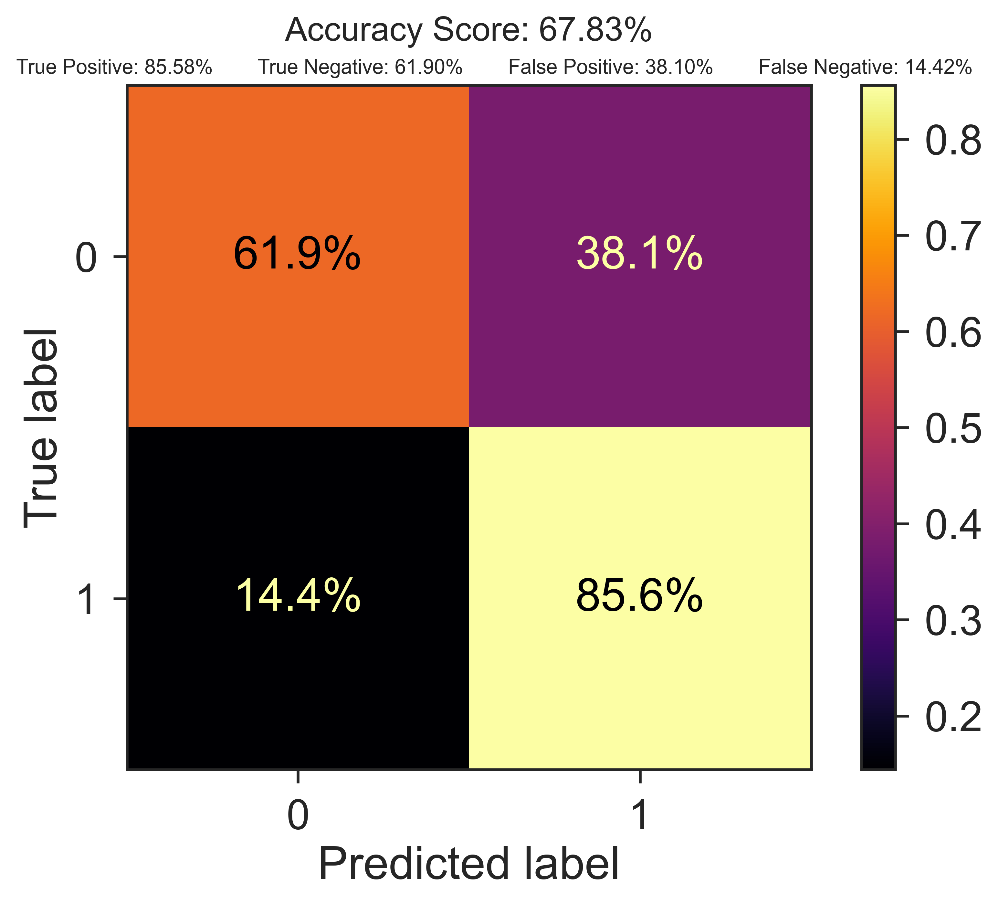

In [36]:
plot_confusion_matrix(gnb,X_test, y_test, cmap='inferno', normalize='true',values_format='.1%')
plt.title('Accuracy Score: {:.2%}'.format(score), size = 15,pad=20);
plt.grid(False)
cm= confusion_matrix(y_test,y_pred)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
sup='True Positive: '+'{:.2%}'.format(cm[1][1])+' '*8+'True Negative: '+ '{:.2%}'.format(cm[0][0]
)+' '*8+'False Positive: '+'{:.2%}'.format(cm[0][1])+' '*8+'False Negative: '+'{:.2%}'.format(cm[1][0])
plt.suptitle(str(sup),size=9,y=.91);

In [37]:
cm= confusion_matrix(y_test,y_pred)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
print('True Positive', '{:.2%}'.format(cm[1][1]))
print('True Negative', '{:.2%}'.format(cm[0][0]))
print('False Positive','{:.2%}'.format(cm[0][1]))
print('False Negative','{:.2%}'.format(cm[1][0]))

True Positive 85.58%
True Negative 61.90%
False Positive 38.10%
False Negative 14.42%


In [38]:
from sklearn.metrics import f1_score, precision_score, recall_score,accuracy_score,roc_curve
#print model precision
y_pred = gnb.predict(X_test)
print('Precision: ','{:.1%}'.format(precision_score(y_test,y_pred)),'\n','--------------------------------------')
print('Recall: ','{:.1%}'.format(recall_score(y_test,y_pred)),'\n','--------------------------------------')
print('F-measure: ','{:.1%}'.format(f1_score(y_test,y_pred)),'\n','--------------------------------------')
print('Accuracy: ','{:.1%}'.format(accuracy_score(y_test,y_pred)),'\n','--------------------------------------')
print('Missclassification Rate (Error rate): ','{:.1%}'.format(1-accuracy_score(y_test,y_pred)),'\n')

Precision:  42.9% 
 --------------------------------------
Recall:  85.6% 
 --------------------------------------
F-measure:  57.1% 
 --------------------------------------
Accuracy:  67.8% 
 --------------------------------------
Missclassification Rate (Error rate):  32.2% 



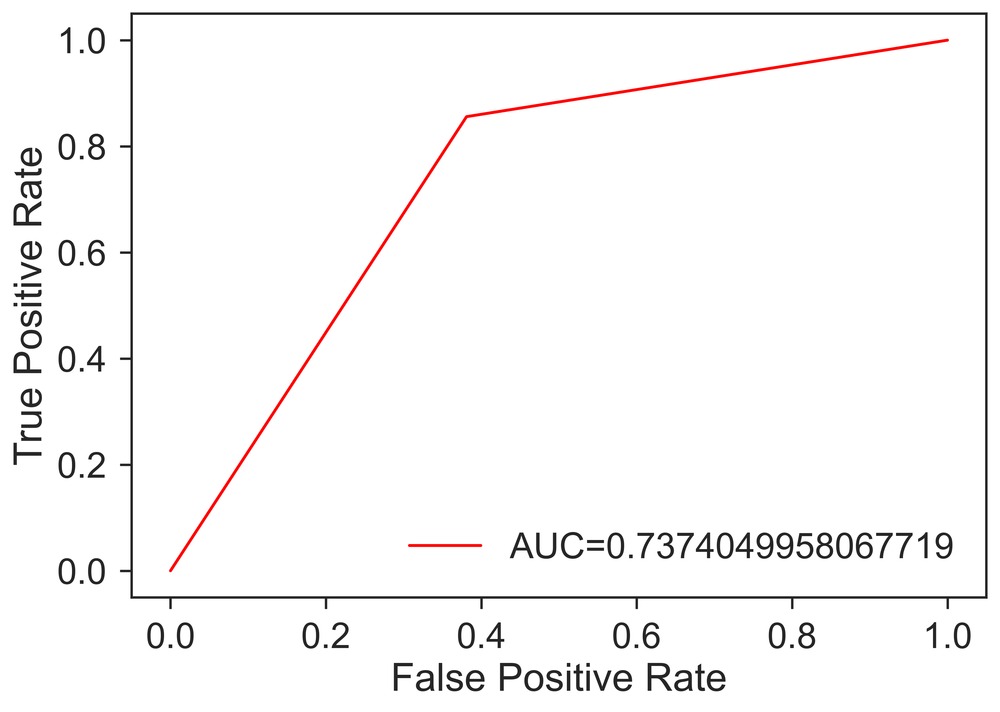

In [39]:
from sklearn import metrics
fpr, tpr, _ = metrics.roc_curve(y_test, y_pred)
auc = metrics.roc_auc_score(y_test, y_pred)
plt.plot(fpr,tpr,label="AUC="+str(auc),color='red') # Area under the curve
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

# Algorithm #2: Logistic Regression

In [40]:
# test to get the best random state 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

x = df_encoded.drop('Churn',axis=1) # Independent variables - remove the dependant variable
y = df_encoded['Churn'] # Dependent variable
random_states = np.arange(start=0, stop=100)
scores=[]
logisticRegr = LogisticRegression(solver='lbfgs', max_iter=2000)
for state in random_states:
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.25, random_state=state)
    logisticRegr.fit(x_train, y_train)
    R_square = logisticRegr.score(x_test,y_test)
    t='Best R^2 obtained is:'+str(R_square)+' RS='+str(state)
    scores.append(t)    
print(max(scores))

Best R^2 obtained is:0.8193807339449541 RS=4


In [41]:
# Logistic Regression 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

x = df_encoded.drop('Churn',axis=1) # Independent variables - remove the dependant variable
y = df_encoded['Churn'] # Dependent variable
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size=0.25, random_state=4)
logisticRegr = LogisticRegression(solver='lbfgs', max_iter=2000)
logisticRegr.fit(x_train, y_train)
predictions = logisticRegr.predict(x_test)
# Use score method to get accuracy of model
score = logisticRegr.score(x_test, y_test)
print("Accuracy Score: ",'{:.2%}'.format(score))

Accuracy Score:  81.94%


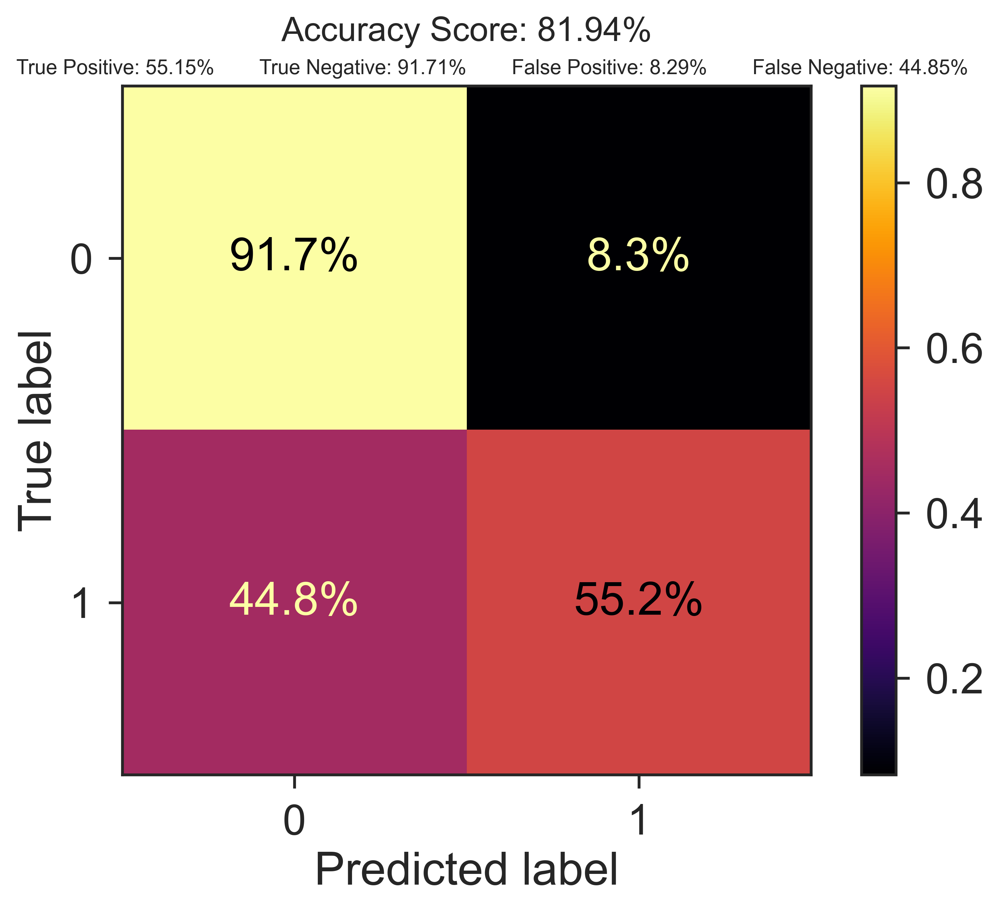

In [42]:
fig=plot_confusion_matrix(logisticRegr,x_test, y_test, cmap='inferno', normalize='true',values_format='.1%')
plt.title('Accuracy Score: {:.2%}'.format(score), size = 15,pad=20);
plt.grid(False)
cm= confusion_matrix(y_test,predictions)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
sup='True Positive: '+'{:.2%}'.format(cm[1][1])+' '*8+'True Negative: '+ '{:.2%}'.format(cm[0][0]
)+' '*8+'False Positive: '+'{:.2%}'.format(cm[0][1])+' '*8+'False Negative: '+'{:.2%}'.format(cm[1][0])
plt.suptitle(str(sup),size=9,y=.91);

In [43]:
cm= confusion_matrix(y_test,predictions)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
print('True Positive', '{:.2%}'.format(cm[1][1]))
print('True Negative', '{:.2%}'.format(cm[0][0]))
print('False Positive','{:.2%}'.format(cm[0][1]))
print('False Negative','{:.2%}'.format(cm[1][0]))

True Positive 55.15%
True Negative 91.71%
False Positive 8.29%
False Negative 44.85%


In [44]:
from sklearn.metrics import f1_score, precision_score, recall_score,accuracy_score,roc_curve
#print model precision
predictions = logisticRegr.predict(x_test)
print('Precision: ','{:.1%}'.format(precision_score(y_test,predictions)),'\n','--------------------------------------')
print('Recall: ','{:.1%}'.format(recall_score(y_test,predictions)),'\n','--------------------------------------')
print('F-measure: ','{:.1%}'.format(f1_score(y_test,predictions)),'\n','--------------------------------------')
print('Accuracy: ','{:.1%}'.format(accuracy_score(y_test,predictions)),'\n','--------------------------------------')
print('Missclassification Rate (Error rate): ','{:.1%}'.format(1-accuracy_score(y_test,predictions)),'\n')

Precision:  70.8% 
 --------------------------------------
Recall:  55.2% 
 --------------------------------------
F-measure:  62.0% 
 --------------------------------------
Accuracy:  81.9% 
 --------------------------------------
Missclassification Rate (Error rate):  18.1% 



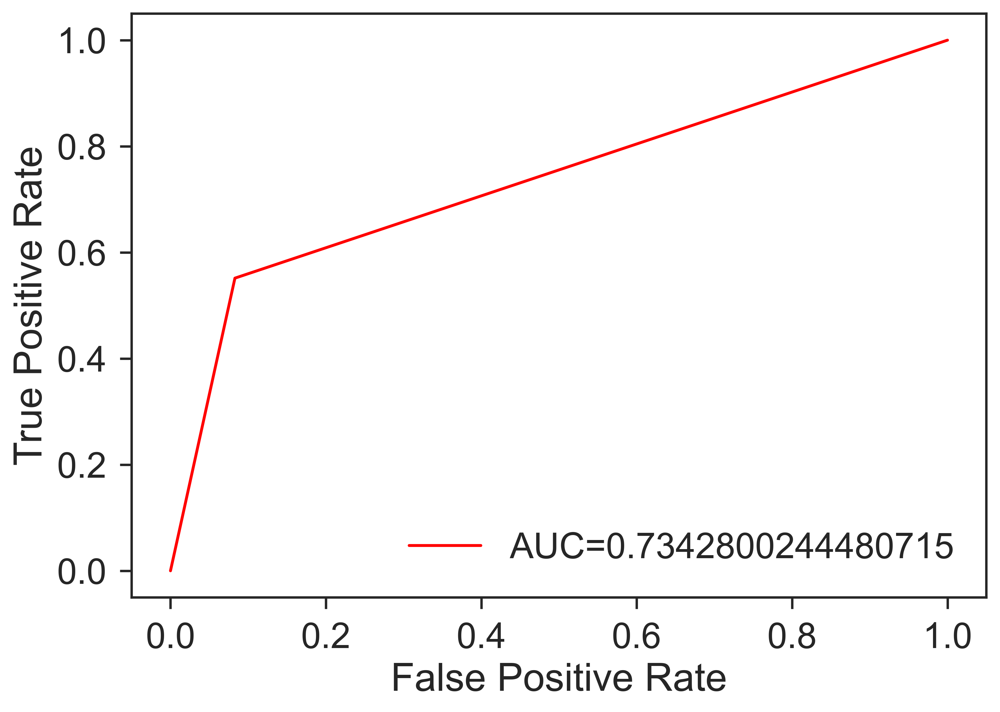

In [45]:
from sklearn import metrics
fpr, tpr, _ = metrics.roc_curve(y_test, predictions)
auc = metrics.roc_auc_score(y_test, predictions)
plt.plot(fpr,tpr,label="AUC="+str(auc),color='red') # Area under the curve
plt.ylabel('True Positive Rate')
plt.xlabel('False Positive Rate')
plt.legend(loc=4)
plt.show()

# Conclusion

Between the 2 suggested algorithms: (Logistic Regression and Naive Bayes), the one that should be chose is the Logistic Regression. Using the logistic Regression classification algorithm we managed to achieve a higher accuracy than the Naive Bayes algorith and the initial Decision Tree classifier.

The results were as follows:
-   With the initial Decsion Tree algorithm we managed to get:
    - A model Precision of 50.1 %
    - A model accuracy of 74.7 %
    - A model recall of 52.3 %
    - A model F-measure of 51.2 %
    - A model Error Rate of 25.3 %
    - A model True Positive of 52.26 %
    - A model True Negative of 82.34 %
    - A model False Positive of 17.66 %
    - A model False Negative of 47.74 %
    - A model AUC of 67.30 %
---
-   With the #1 proposed algorithm - Naive Bayes algorithm we managed to get:
    - A model Precision of 42.9 %
    - A model accuracy of 67.8 %
    - A model recall of 85.6 %
    - A model F-measure of 57.1 %
    - A model Error Rate of 32.2 %
    - A model True Positive of 85.58 %
    - A model True Negative of 61.90 %
    - A model False Positive of 38.10 %
    - A model False Negative of 14.42 %
    - A model AUC of 73.74 %
---
-   With the #2 proposed algorithm - Logistic Regression algorithm we managed to get:
    - A model Precision of 70.8 %
    - A model accuracy of 81.9 %
    - A model recall of 55.2 %
    - A model F-measure of 62.0 %
    - A model Error Rate of 18.1 %
    - A model True Positive of 55.15 %
    - A model True Negative of 91.71 %
    - A model False Positive of 8.29 %
    - A model False Negative of 44.85 %
    - A model AUC of 73.42 %

We suggested 2 new classification algorithms: #1 Gaussian Naive Bayes and #2 Logistic Regression. We also have the Decision tree algorithm that we initially used before. The best classification model out of the three is the Logistic Regression classification method.
The Logistic Regression is the best of the three, because the model has the highest accuracy of 81.9% and also the lowest Misclassification Rate of 18.1%. The LR model also has the lowest False positive by far compared to other alogrithms. It has only 8.29 % compared to the other two. The model Precision is also the highest among the three with 70.8 %.
